In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

Data Loading And Preparation

In [7]:
dt=pd.read_csv("/Users/steffidorothy/Downloads/KDD/Pakistan Largest Ecommerce Dataset.csv", low_memory=False, parse_dates=["created_at", "Working Date", "Customer Since"])
print("Data Dimensions are:", dt.shape)
print("Columns are:", dt.columns)

Data Dimensions are: (1048575, 26)
Columns are: Index(['item_id', 'status', 'created_at', 'sku', 'price', 'qty_ordered',
       'grand_total', 'increment_id', 'category_name_1',
       'sales_commission_code', 'discount_amount', 'payment_method',
       'Working Date', 'BI Status', ' MV ', 'Year', 'Month', 'Customer Since',
       'M-Y', 'FY', 'Customer ID', 'Unnamed: 21', 'Unnamed: 22', 'Unnamed: 23',
       'Unnamed: 24', 'Unnamed: 25'],
      dtype='object')


In [8]:
print(dt.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 26 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   item_id                584524 non-null  float64       
 1   status                 584509 non-null  object        
 2   created_at             584524 non-null  datetime64[ns]
 3   sku                    584504 non-null  object        
 4   price                  584524 non-null  float64       
 5   qty_ordered            584524 non-null  float64       
 6   grand_total            584524 non-null  float64       
 7   increment_id           584524 non-null  object        
 8   category_name_1        584360 non-null  object        
 9   sales_commission_code  447346 non-null  object        
 10  discount_amount        584524 non-null  float64       
 11  payment_method         584524 non-null  object        
 12  Working Date           584524 non-null  da

In [9]:
#drop last 5 empty columns
dt=dt.iloc[:,:-5]
dt=dt.dropna(how='all')
print(f"After removing the columns, The nummber of rows are {dt.shape[0]} and the number of columns {dt.shape[1]}")

After removing the columns, The nummber of rows are 584524 and the number of columns 21


In [10]:
dt.rename(columns={' MV ':'MV'}, inplace=True)
dt.columns

Index(['item_id', 'status', 'created_at', 'sku', 'price', 'qty_ordered',
       'grand_total', 'increment_id', 'category_name_1',
       'sales_commission_code', 'discount_amount', 'payment_method',
       'Working Date', 'BI Status', 'MV', 'Year', 'Month', 'Customer Since',
       'M-Y', 'FY', 'Customer ID'],
      dtype='object')

In [11]:
#Change column name of category_name_1 to Category
dt.rename(columns={'category_name_1':'Category'}, inplace=True)
dt.columns

Index(['item_id', 'status', 'created_at', 'sku', 'price', 'qty_ordered',
       'grand_total', 'increment_id', 'Category', 'sales_commission_code',
       'discount_amount', 'payment_method', 'Working Date', 'BI Status', 'MV',
       'Year', 'Month', 'Customer Since', 'M-Y', 'FY', 'Customer ID'],
      dtype='object')

In [12]:
#perform casting
dt['Customer ID']=dt['Customer ID'].astype(str)
dt['item_id']=dt['item_id'].astype(str)
dt['qty_ordered']=dt['qty_ordered'].astype(int)
dt['Year']=dt['Year'].astype(int)
dt['Month']=dt['Month'].astype(int)

DATA STATISTICS

In [14]:
dt.tail()

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,Category,sales_commission_code,...,payment_method,Working Date,BI Status,MV,Year,Month,Customer Since,M-Y,FY,Customer ID
584519,905204.0,cod,2018-08-28,WOFSCE5AE00357AECDE,699.0,1,849.0,100562385,Women's Fashion,NaN,...,cod,2018-08-28,Valid,699,2018,8,2018-08-01,8-2018,FY19,115320.0
584520,905205.0,processing,2018-08-28,MATHUA5AF70A7D1E50A,35599.0,1,35899.0,100562386,Mobiles & Tablets,NaN,...,bankalfalah,2018-08-28,Gross,"35,599",2018,8,2018-08-01,8-2018,FY19,115326.0
584521,905206.0,processing,2018-08-28,MATSAM5B6D7208C6D30,129999.0,2,652178.0,100562387,Mobiles & Tablets,NaN,...,bankalfalah,2018-08-28,Gross,"259,998",2018,8,2018-07-01,8-2018,FY19,113474.0
584522,905207.0,processing,2018-08-28,MATSAM5B1509B4696EA,87300.0,2,652178.0,100562387,Mobiles & Tablets,NaN,...,bankalfalah,2018-08-28,Gross,"174,600",2018,8,2018-07-01,8-2018,FY19,113474.0
584523,905208.0,processing,2018-08-28,MATSAM5B10F91A9B6AB,108640.0,2,652178.0,100562387,Mobiles & Tablets,NaN,...,bankalfalah,2018-08-28,Gross,"217,280",2018,8,2018-07-01,8-2018,FY19,113474.0


In [15]:
#Check duplicate row
duplicates=dt.duplicated()
print(duplicates)

0         False
1         False
2         False
3         False
4         False
          ...  
584519    False
584520    False
584521    False
584522    False
584523    False
Length: 584524, dtype: bool


In [16]:
#No duplicate row found
num_duplicates=duplicates.sum()
print(num_duplicates)

0


In [17]:
print(len(dt))

584524


In [18]:
#Display first 5 records
dt.head()

,item_id,status,created_at,sku,price,qty_ordered,grand_total,increment_id,Category,sales_commission_code,...,payment_method,Working Date,BI Status,MV,Year,Month,Customer Since,M-Y,FY,Customer ID
0,211131.0,complete,2016-07-01,kreations_YI 06-L,1950.0,1,1950.0,100147443,Women's Fashion,\N,...,cod,2016-07-01,#REF!,"1,950",2016,7,2016-07-01,7-2016,FY17,1.0
1,211133.0,canceled,2016-07-01,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,240.0,1,240.0,100147444,Beauty & Grooming,\N,...,cod,2016-07-01,Gross,240,2016,7,2016-07-01,7-2016,FY17,2.0
2,211134.0,canceled,2016-07-01,Ego_UP0017-999-MR0,2450.0,1,2450.0,100147445,Women's Fashion,\N,...,cod,2016-07-01,Gross,"2,450",2016,7,2016-07-01,7-2016,FY17,3.0
3,211135.0,complete,2016-07-01,kcc_krone deal,360.0,1,60.0,100147446,Beauty & Grooming,R-FSD-52352,...,cod,2016-07-01,Net,360,2016,7,2016-07-01,7-2016,FY17,4.0
4,211136.0,order_refunded,2016-07-01,BK7010400AG,555.0,2,1110.0,100147447,Soghaat,\N,...,cod,2016-07-01,Valid,"1,110",2016,7,2016-07-01,7-2016,FY17,5.0


handle the missing values

In [20]:
dt.isnull().sum()

item_id                       0
status                       15
created_at                    0
sku                          20
price                         0
qty_ordered                   0
grand_total                   0
increment_id                  0
Category                    164
sales_commission_code    137178
discount_amount               0
payment_method                0
Working Date                  0
BI Status                     0
MV                            0
Year                          0
Month                         0
Customer Since               11
M-Y                           0
FY                            0
Customer ID                   0
dtype: int64

Text(0.5, 1.0, 'percentage of missing values in each column')

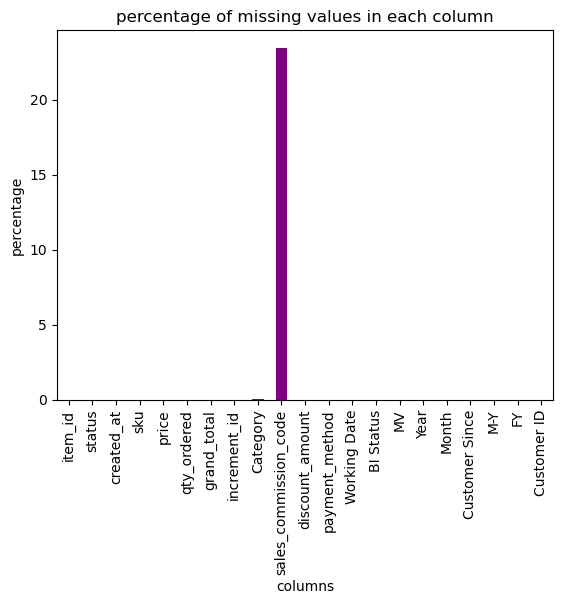

In [21]:
missing_percentage=dt.isnull().sum()/len(dt)*100
missing_percentage.plot(kind='bar', color='purple')
# add labels
plt.xlabel('columns')
plt.ylabel('percentage')
plt.title("percentage of missing values in each column")

In [22]:
#summary of data
dt.describe()

,created_at,price,qty_ordered,grand_total,discount_amount,Working Date,Year,Month,Customer Since
count,584524,5.845240e+05,584524.000000,5.845240e+05,584524.000000,584524,584524.000000,584524.000000,584513
mean,2017-08-08 11:42:53.589450752,6.348748e+03,1.296388,8.530619e+03,499.492775,2017-08-08 11:42:53.589450752,2017.044115,7.167654,2017-04-24 18:56:21.904593664
min,2016-07-01 00:00:00,0.000000e+00,1.000000,-1.594000e+03,-599.500000,2016-07-01 00:00:00,2016.000000,1.000000,2016-07-01 00:00:00
25%,2017-01-29 00:00:00,3.600000e+02,1.000000,9.450000e+02,0.000000,2017-01-29 00:00:00,2017.000000,4.000000,2016-11-01 00:00:00
50%,2017-08-17 00:00:00,8.990000e+02,1.000000,1.960400e+03,0.000000,2017-08-17 00:00:00,2017.000000,7.000000,2017-04-01 00:00:00
75%,2018-02-03 00:00:00,4.070000e+03,1.000000,6.999000e+03,160.500000,2018-02-03 00:00:00,2018.000000,11.000000,2017-11-01 00:00:00
max,2018-08-28 00:00:00,1.012626e+06,1000.000000,1.788800e+07,90300.000000,2018-08-28 00:00:00,2018.000000,12.000000,2018-08-01 00:00:00
std,NaN,1.494927e+04,3.996061,6.132081e+04,1506.943046,NaN,0.707355,3.486305,NaN


In [23]:
dt.describe(include=['object', 'bool'])

,item_id,status,sku,increment_id,Category,sales_commission_code,payment_method,BI Status,MV,M-Y,FY,Customer ID
count,584524,584509,584504,584524,584360,447346,584524,584524,584524,584524,584524,584524
unique,584524,16,84889,408782,16,7225,18,4,9720,26,3,115327
top,211131.0,complete,MATSAM59DB75ADB2F80,100266667,Mobiles & Tablets,\N,cod,Net,999,11-2017,FY18,85775.0
freq,1,233685,3775,72,115710,339001,271960,234178,9516,83928,306883,2524


DATA ANALYSIS

Grand Total

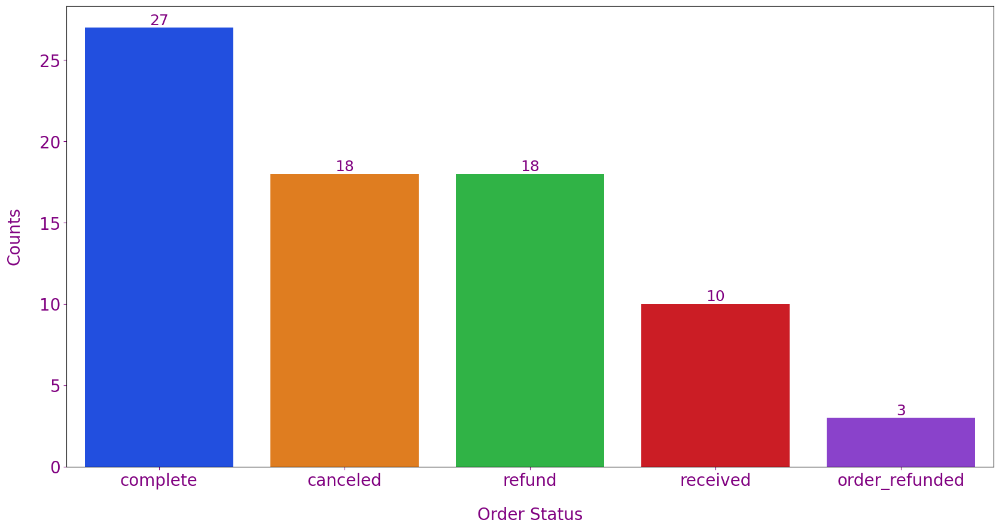

In [26]:
total=dt[dt.grand_total<0].status.value_counts().to_dict()
total_df=pd.DataFrame(list(total.items()), columns=['Order Status', 'Counts'])
plt.figure(figsize=(20,10))
ax = sns.barplot(data=total_df, x='Order Status', y='Counts', palette='bright')
ax.bar_label(container=ax.containers[0], padding=0, fontsize=18, color='purple')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Order Status',fontsize=20, labelpad=20, color='purple')
plt.ylabel('Counts', fontsize=20, labelpad=20, color='purple')
ax.tick_params(axis='x', colors='Purple')
ax.tick_params(axis='y', colors='purple')

In [27]:
dt=dt[dt.grand_total>0]

Order Status

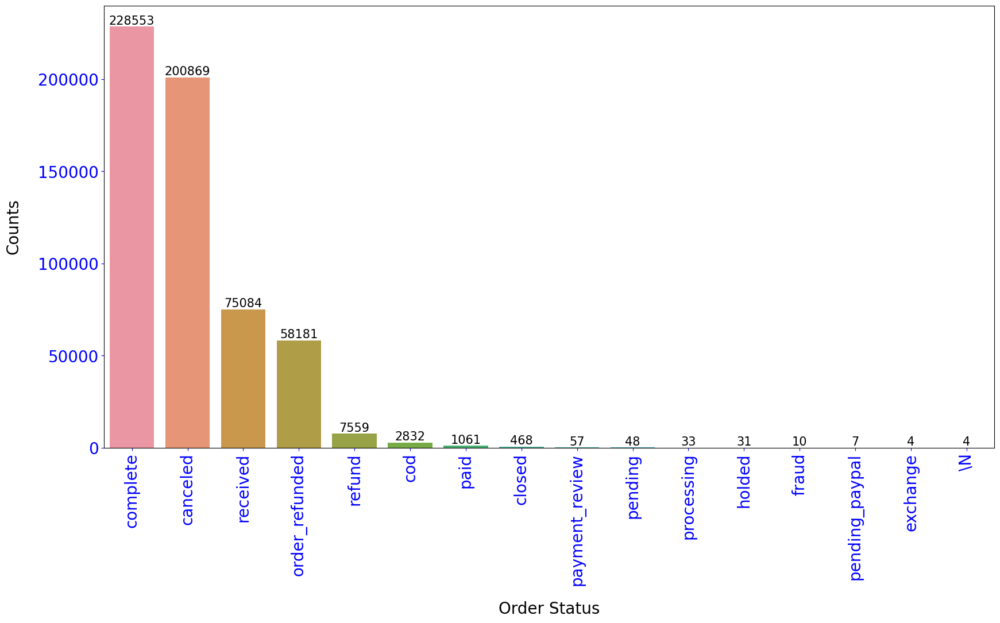

In [29]:
plt.figure(figsize=(20,10))
status=dt.status.value_counts()
status_df=pd.DataFrame(list(status.items()),columns=['Order Status', 'Counts'])
ax=sns.barplot(data=status_df, x='Order Status', y='Counts')
ax.bar_label(container=ax.containers[0], padding=0, fontsize=15)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Order Status', fontsize=20, labelpad=20)
plt.ylabel('Counts', fontsize=20, labelpad=20)
plt.xticks(rotation=90, ha='center')
ax.tick_params(axis='x', colors='blue')
ax.tick_params(axis='y', colors='blue')

Grouping Of Order Status

What are the cancellation and return rates for different categories? Do certain categories experience higher return rates?

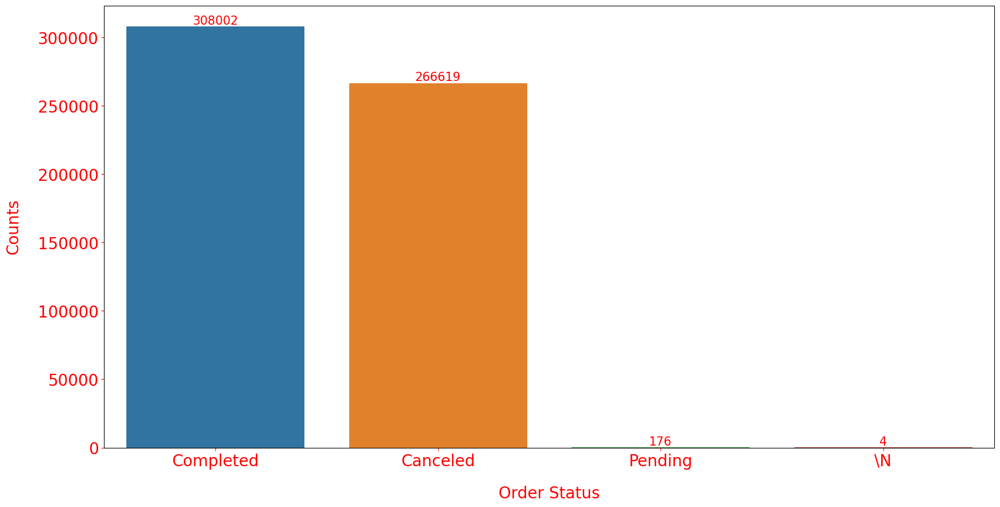

In [32]:
dt.status=dt.status.replace({'complete':'Completed', 'received':'Completed', 'cod':'Completed', 'paid':'Completed', 'closed':'Completed', 'exchange':'Completed', 'canceled':'Canceled', 'order_refunded':'Canceled', 'refund':'Canceled', 'fraud':'Canceled', 'payment_review':'Pending', 'pending':'Pending', 'processing':'Pending', 'holded':'Pending','pending_paypal':'Pending'})
plt.figure(figsize=(20,10))
status_updated=dt.status.value_counts()
status_updated_df=pd.DataFrame(list(status_updated.items()), columns=['Order Status', 'Counts'])
ax=sns.barplot(data=status_updated_df, x='Order Status', y='Counts')
ax.bar_label(container=ax.containers[0], padding=0, fontsize=15, color='red')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Order Status', fontsize=20, labelpad=20, color='red')
plt.ylabel('Counts', fontsize=20, labelpad=20, color='red')
ax.tick_params(axis='x', colors='red')
ax.tick_params(axis='y', colors='red')

In [33]:
dt.status.str.count('Canceled').sum()

266619.0

In [34]:
canceled_orders=dt[dt.status=='Canceled']
canceled_counts=canceled_orders.groupby('Category')['Customer ID'].count()
print(canceled_counts)

Category
Appliances            26662
Beauty & Grooming     13830
Books                   509
Computing              8605
Entertainment         14758
Health & Sports        5780
Home & Living         10139
Kids & Baby            6176
Men's Fashion         38496
Mobiles & Tablets     65102
Others                19652
School & Education     1289
Soghaat                9763
Superstore            16292
Women's Fashion       25008
\N                     4405
Name: Customer ID, dtype: int64


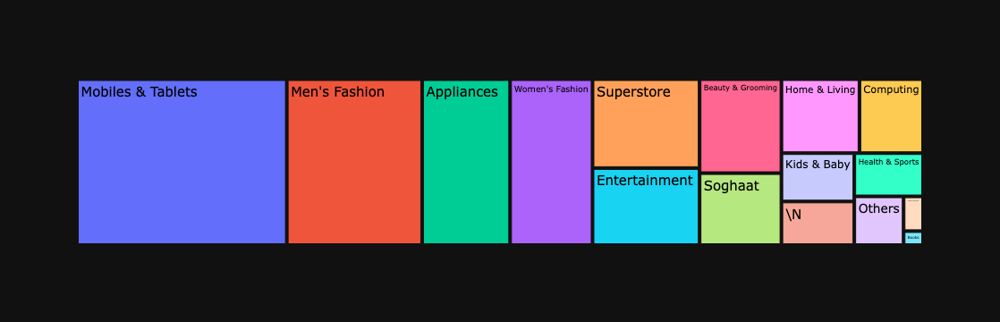

In [35]:
canceled_orders=canceled_orders.dropna()
fig=px.treemap(canceled_orders, path=['Category'], template='plotly_dark')
fig.update_traces(textfont_color='black', textfont_size=15, selector=dict(type='treemap'))
fig.show()

Which Category has highest number of orders

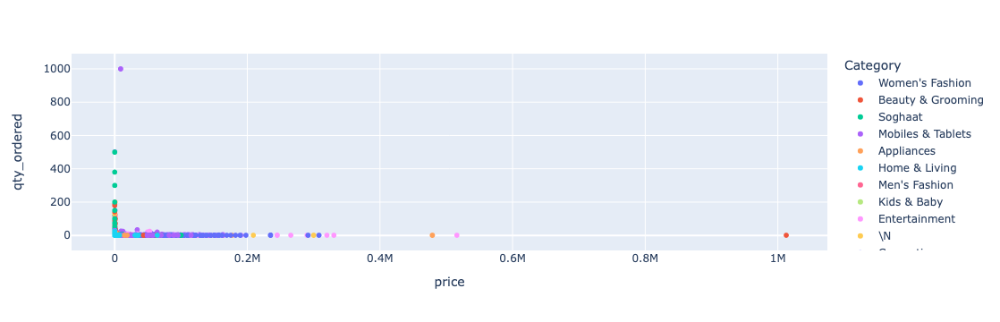

<Figure size 6000x3000 with 0 Axes>

In [37]:
plt.figure(figsize=(60,30))
fig=px.scatter(dt, x='price', y='qty_ordered', color='Category')
fig.show()

Bar Plot

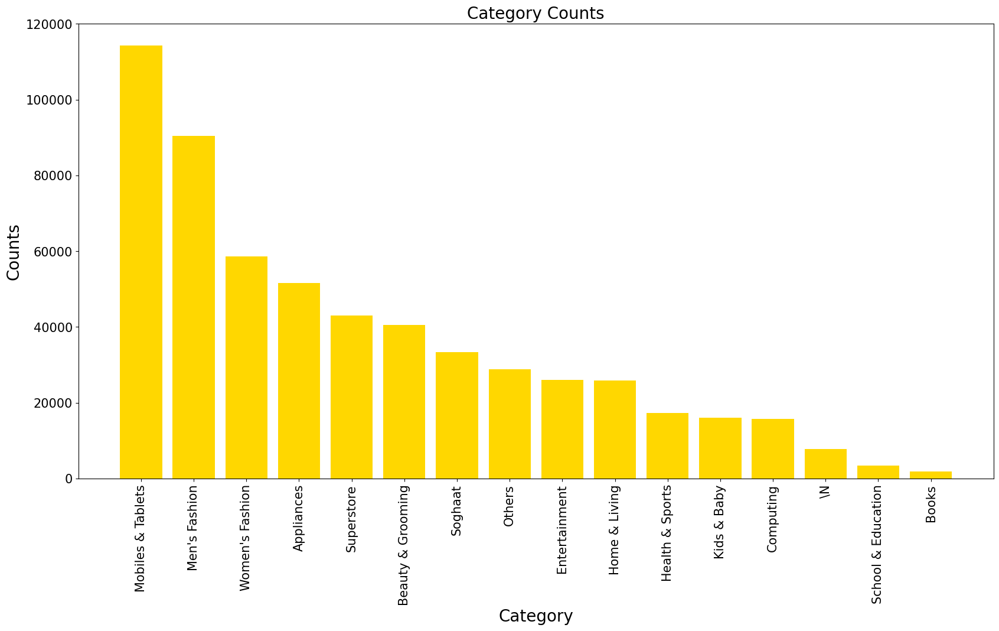

In [39]:
cat_counts=dt['Category'].value_counts()
plt.figure(figsize=(20,10))
plt.bar(cat_counts.index, cat_counts, color='Gold')
plt.title('Category Counts', fontsize=20)
plt.xlabel('Category',fontsize=20)
plt.ylabel('Counts',fontsize=20)
plt.xticks(rotation=90, fontsize=15)
plt.yticks(fontsize=15)
plt.show()

In [40]:
dt.head().T

,0,1,2,3,4
item_id,211131.0,211133.0,211134.0,211135.0,211136.0
status,Completed,Canceled,Canceled,Completed,Canceled
created_at,2016-07-01 00:00:00,2016-07-01 00:00:00,2016-07-01 00:00:00,2016-07-01 00:00:00,2016-07-01 00:00:00
sku,kreations_YI 06-L,kcc_Buy 2 Frey Air Freshener & Get 1 Kasual Bo...,Ego_UP0017-999-MR0,kcc_krone deal,BK7010400AG
price,1950.0,240.0,2450.0,360.0,555.0
qty_ordered,1,1,1,1,2
grand_total,1950.0,240.0,2450.0,60.0,1110.0
increment_id,100147443,100147444,100147445,100147446,100147447
Category,Women's Fashion,Beauty & Grooming,Women's Fashion,Beauty & Grooming,Soghaat
sales_commission_code,\N,\N,\N,R-FSD-52352,\N


In [41]:
dt['status'].unique()

array(['Completed', 'Canceled', 'Pending', '\\N', nan], dtype=object)

In [42]:
dt['M-Y'].unique()

array(['7-2016', '8-2016', '9-2016', '10-2016', '11-2016', '12-2016',
       '1-2017', '2-2017', '3-2017', '4-2017', '5-2017', '6-2017',
       '7-2017', '8-2017', '9-2017', '10-2017', '11-2017', '12-2017',
       '2-2018', '1-2018', '3-2018', '4-2018', '5-2018', '6-2018',
       '7-2018', '8-2018'], dtype=object)

In [43]:
dt.describe().T

,count,mean,min,25%,50%,75%,max,std
created_at,574816,2017-08-08 08:48:54.131269888,2016-07-01 00:00:00,2017-01-28 00:00:00,2017-08-18 00:00:00,2018-02-01 00:00:00,2018-08-28 00:00:00,NaN
price,574816.0,6401.27313,0.0,360.0,900.0,4312.0,1012625.9,15008.69844
qty_ordered,574816.0,1.298043,1.0,1.0,1.0,1.0,1000.0,4.006833
grand_total,574816.0,8674.730352,0.21,993.65,1999.0,7220.8,17888000.0,61826.355272
discount_amount,574816.0,497.626896,-599.5,0.0,0.0,162.0,90300.0,1499.862692
Working Date,574816,2017-08-08 08:48:54.131269888,2016-07-01 00:00:00,2017-01-28 00:00:00,2017-08-18 00:00:00,2018-02-01 00:00:00,2018-08-28 00:00:00,NaN
Year,574816.0,2017.04257,2016.0,2017.0,2017.0,2018.0,2018.0,0.707236
Month,574816.0,7.181199,1.0,4.0,7.0,11.0,12.0,3.486722
Customer Since,574805,2017-04-24 18:20:36.502813184,2016-07-01 00:00:00,2016-11-01 00:00:00,2017-04-01 00:00:00,2017-11-01 00:00:00,2018-08-01 00:00:00,NaN


How does the number of orders vary over time?

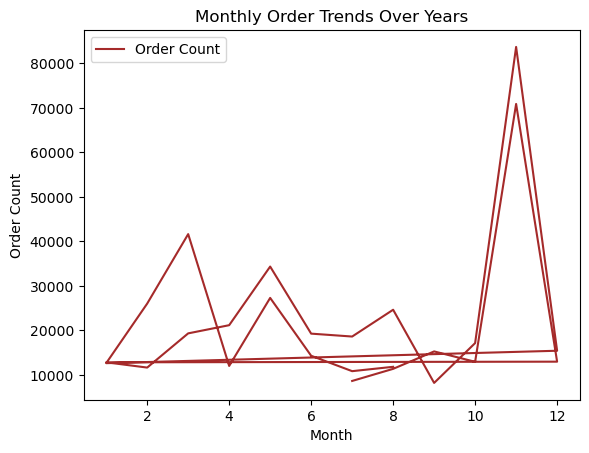

In [78]:
dt['Year']=dt['Working Date'].dt.year
dt['Month']=dt['Working Date'].dt.month
#Group by month and year
orders_by_month=dt.groupby(['Year', 'Month'])['item_id'].count()
#reset index
orders_by_month=orders_by_month.reset_index(name='Order Count')
#Plot monthly counts
orders_by_month.plot(x='Month', y='Order Count', color='brown')
#Add labels
plt.title('Monthly Order Trends Over Years')
plt.xlabel('Month')
plt.ylabel('Order Count')
plt.legend()
plt.show()

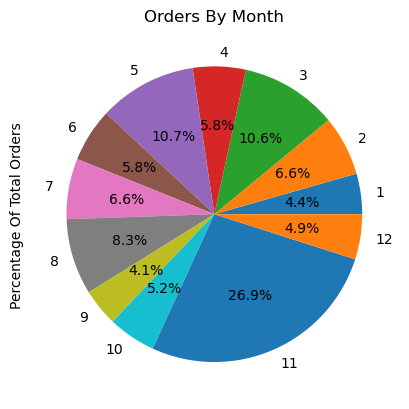

In [84]:
dt['Month']=dt['Working Date'].dt.month
#Groupby month and count orders
monthly_counts=dt.groupby('Month')['item_id'].count()
#Plot pie chart
plt.pie(monthly_counts, labels=monthly_counts.index, autopct='%1.1f%%')
#Add labels and title
plt.title('Orders By Month')
plt.ylabel('Percentage Of Total Orders')
plt.show()

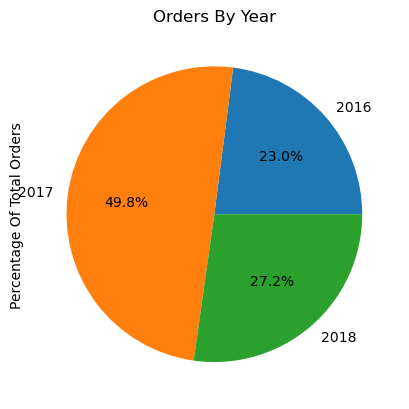

In [86]:
dt['Year']=dt['Working Date'].dt.year
#Groupby year and count of orders
yearly_counts=dt.groupby('Year')['item_id'].count()
#Plot pie chart
plt.pie(yearly_counts, labels=yearly_counts.index, autopct='%1.1f%%')
#Add title and labels
plt.title('Orders By Year')
plt.ylabel('Percentage Of Total Orders')
plt.show()

How many customers return? Over time, what percentage of orders are from returning versus new customers?

In [92]:
num_customers=dt['Customer ID'].nunique()
#Groupby customerID and order count
customer_orders=dt.groupby('Customer ID')['item_id'].count()
#Filter customers with more than one order
repeat_customers=customer_orders[customer_orders>1]
#Calculate number and percentage of repeat customers
num_repeat=len(repeat_customers)
percent_repeat=num_repeat/num_customers
print(f"Number Of Returning Customers:{num_repeat}")
print(f"Percentage Of Returning Customers:{percent_repeat*100}%")


Number Of Returning Customers:64377
Percentage Of Returning Customers:55.99509432977585%


In [100]:
num_customers=dt['Customer ID'].nunique()
#Groupby customerID and count orders
customer_orders=dt.groupby('Customer ID')['item_id'].count()
#Filter customers with only one order
new_customers=customer_orders[customer_orders==1]
#Number Of New Customers
num_new=len(new_customers)
#Percentage of new customers
percent_new=num_new/num_customers
print(f"Number Of New Customers: {num_new}")
print(f"Percentage Of New Customers:{percent_new*100}%")

Number Of New Customers: 50592
Percentage Of New Customers:44.00490567022415%


In [102]:
print(f"Percentage Of Returning Customers:{percent_repeat*100}% vs Percentage Of New Customers:{percent_new*100}%")

Percentage Of Returning Customers:55.99509432977585% vs Percentage Of New Customers:44.00490567022415%


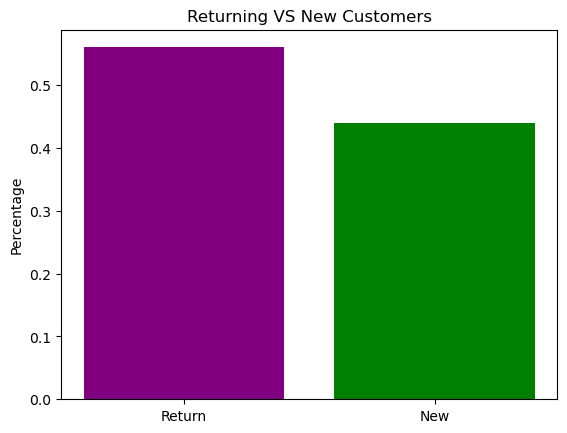

In [110]:
data=[percent_repeat, percent_new]
indexes=[0,1]
labels=['Return', 'New']
plt.bar(indexes, data, tick_label=labels, color=('purple', 'green'))
plt.title("Returning VS New Customers")
plt.ylabel("Percentage")
plt.xticks(indexes, labels)
plt.show()

Orders Per Category

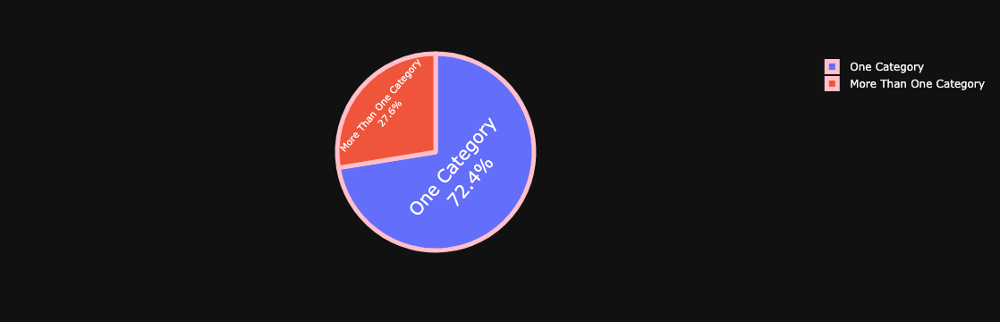

In [120]:
number_of_prod=dt.groupby('Customer ID')['Category'].nunique().sort_values(ascending=False)
number_of_prod_df=pd.DataFrame(list(number_of_prod.items()), columns=['Customer ID', 'Number Of Products'])
a=number_of_prod_df[number_of_prod_df['Number Of Products']==1].value_counts().sum()
b=number_of_prod_df[number_of_prod_df['Number Of Products']!=1].value_counts().sum()
data={'Order':['One Category', 'More Than One Category'], 'Customer_Counts':[a,b]}
category_counts=pd.DataFrame.from_dict(data)
fig=px.pie(category_counts, values=category_counts.Customer_Counts, names=category_counts.Order, template='plotly_dark')
fig.update_traces(textposition="inside", textinfo='percent+label', textfont_size=20, textfont_color='white', marker=dict(line=dict(color='pink', width=5)))
fig.show()

Canceled Orders

In [ ]:
a=dt['Customer ID'].nunique()+canceled_orders['Customer ID'].nunique()
b=canceled_orders['Customer ID'].nunique()
data={'Customers':['Total Customers', 'Those Who Canceled']'Customer_Counts':[a,b]}
customer_counts=pd.DataFrame.from_dict(data)
c=dt['increment_id'].nunique()+canceled_orders['increment_id'].nunique()
d=canceled_orders['increment_id'].nunique()
data={'Orders':['Total Orders', 'Canceled_Orders'], 'Order_Counts':[c,d]}
order_counts=pd.DataFrame.from_dict(data)
